# Temporal Data Exploration

- Clayton Miller (miller.clayton@gmail.com)

This notebook is for understanding what is contained in the '/data/raw/temp_open.csv' file through visualizations

In [1]:
import pandas as pd
import seaborn as sns
import os
import matplotlib.pyplot as plt


In [2]:
%matplotlib inline

Please fill in the following variable with the path on your computer where the repository is contained:

In [3]:
repos_path = "/Users/Clayton/temporal-features-for-buildings/"

In [4]:
temp = pd.read_csv(os.path.join(repos_path,"data/raw/temp_open.csv"), index_col="timestamp", parse_dates=True)

In [5]:
temp.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 40944 entries, 2010-01-01 00:00:00 to 2015-12-31 23:00:00
Columns: 507 entries, PrimClass_Ernie to UnivLab_Alissa
dtypes: float64(507)
memory usage: 158.7 MB


In [6]:
temp.head()

,PrimClass_Ernie,UnivClass_Corbin,Office_Ellis,Office_Earl,PrimClass_Elisa,Office_Christopher,PrimClass_Jo,PrimClass_Johnnie,Office_Jeannette,PrimClass_Emerald,...,Office_Perry,UnivLab_Barbara,UnivDorm_Cheri,Office_Lana,Office_Makenna,Office_Lee,Office_Cora,UnivLab_Ladonna,UnivLab_Chad,UnivLab_Alissa
timestamp,,,,,,,,,,,,,,,,,,,,,
2010-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,763.550,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,741.625,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,726.775,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,715.025,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,703.600,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Get the Meta Data as well to understand the start and stop times and the primary use types of the data

In [7]:
meta = pd.read_csv(os.path.join(repos_path,"data/raw/meta_open.csv"), index_col='uid')

In [8]:
meta.info()

<class 'pandas.core.frame.DataFrame'>
Index: 507 entries, PrimClass_Ernie to UnivLab_Alissa
Data columns (total 18 columns):
dataend                   507 non-null object
datastart                 507 non-null object
energystarscore           26 non-null float64
heatingtype               124 non-null object
industry                  507 non-null object
mainheatingtype           122 non-null object
numberoffloors            124 non-null float64
occupants                 105 non-null float64
primaryspaceusage         507 non-null object
rating                    131 non-null object
sqft                      507 non-null float64
sqm                       507 non-null float64
subindustry               507 non-null object
timezone                  507 non-null object
yearbuilt                 313 non-null object
nickname                  507 non-null object
primaryspaceuse_abbrev    507 non-null object
newweatherfilename        507 non-null object
dtypes: float64(5), object(13)
memory usage

In [9]:
meta.head()

,dataend,datastart,energystarscore,heatingtype,industry,mainheatingtype,numberoffloors,occupants,primaryspaceusage,rating,sqft,sqm,subindustry,timezone,yearbuilt,nickname,primaryspaceuse_abbrev,newweatherfilename
uid,,,,,,,,,,,,,,,,,,
PrimClass_Ernie,2012-12-31 23:00:00,2012-01-01 00:00:00,NaN,NaN,Education,NaN,NaN,NaN,Primary/Secondary Classroom,NaN,105530,9804.053590,Primary/Secondary School,America/New_York,NaN,Ernie,PrimClass,weather12.csv
UnivClass_Corbin,2015-12-31 23:00:00,2015-01-01 00:00:00,NaN,NaN,Education,NaN,NaN,NaN,College Classroom,NaN,56969,5292.591007,College/University,America/New_York,1967.0,Corbin,UnivClass,weather2.csv
Office_Ellis,2012-12-31 23:00:00,2012-01-01 00:00:00,NaN,NaN,Commercial Property,NaN,NaN,NaN,Office,NaN,294651,27373.961853,Commercial Real Estate,America/Los_Angeles,NaN,Ellis,Office,weather22.csv
Office_Earl,2012-12-31 23:00:00,2012-01-01 00:00:00,NaN,NaN,Commercial Property,NaN,NaN,NaN,Office,NaN,496517,46127.918851,Bank/Financial Services,America/Los_Angeles,NaN,Earl,Office,weather28.csv
PrimClass_Elisa,2012-12-31 23:00:00,2012-01-01 00:00:00,NaN,NaN,Education,NaN,NaN,NaN,Primary/Secondary Classroom,NaN,233062,21652.158986,Primary/Secondary School,America/New_York,NaN,Elisa,PrimClass,weather23.csv


# Plot subplots according to datastart and prim use type

In [10]:
sns.set_style("whitegrid")
sns.set_context(font_scale=1.5)

In [21]:
def plot_buildingtype(meta, temp, primaryusetype):
    for datastarttime in meta.datastart.unique():

        to_plot_info = meta[(meta.primaryspaceuse_abbrev == primaryusetype) & (meta.datastart == datastarttime)]
        to_plot_names = to_plot_info.index.sort_values()
        
        print "Plotting "+primaryusetype+" with start time: "+str(datastarttime)
        print "This includes the following buildings: "+str(list(to_plot_names))
        
        # See if there is any data to be plotted
        try:
            length = len(to_plot_names)
            plotsize = length*2.5

            starttime = datastarttime
            endtime = to_plot_info.dataend.unique()[0]

            to_plot_data = temp[to_plot_names].truncate(before=starttime, after=endtime)

            to_plot_data.plot(subplots=True, figsize=(15,plotsize))
            plt.tight_layout()
            
            starttimestring = str(datastarttime)
            plt.savefig(os.path.join(repos_path,"reports/figures/overviewlinecharts/"+primaryusetype+"_"+starttimestring[:-9]+".png"))
            plt.show()

        except:
            continue

In [22]:
meta.primaryspaceuse_abbrev.unique()

array(['PrimClass', 'UnivClass', 'Office', 'UnivDorm', 'UnivLab'], dtype=object)

## Primary/Secondary Schools

Plotting PrimClass with start time: 2012-01-01 00:00:00
This includes the following buildings: ['PrimClass_Edgar', 'PrimClass_Eleanor', 'PrimClass_Eli', 'PrimClass_Eliana', 'PrimClass_Elisa', 'PrimClass_Elisabeth', 'PrimClass_Eloise', 'PrimClass_Elsie', 'PrimClass_Emanuel', 'PrimClass_Emanuela', 'PrimClass_Emer', 'PrimClass_Emerald', 'PrimClass_Emilio', 'PrimClass_Emily', 'PrimClass_Emma', 'PrimClass_Enrique', 'PrimClass_Eoghan', 'PrimClass_Eric', 'PrimClass_Erica', 'PrimClass_Erika', 'PrimClass_Erin', 'PrimClass_Ernie', 'PrimClass_Eugene', 'PrimClass_Ewan', 'PrimClass_Ezra']


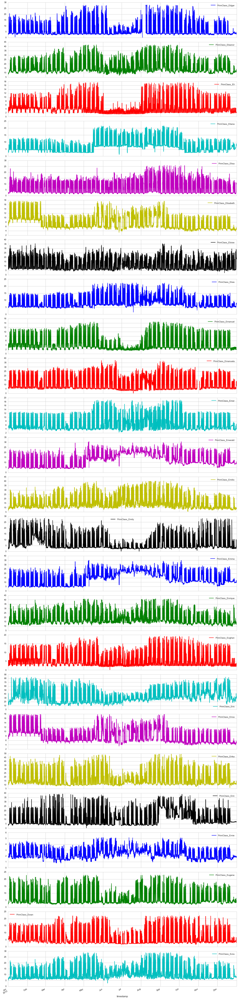

Plotting PrimClass with start time: 2015-01-01 00:00:00
This includes the following buildings: ['PrimClass_Abraham', 'PrimClass_Ashanti']


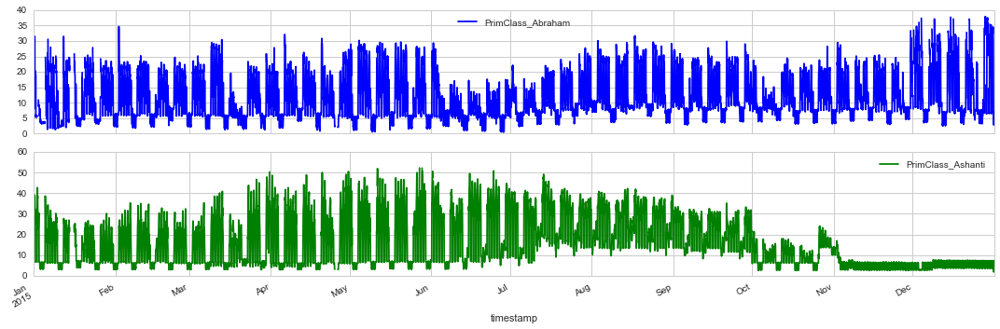

Plotting PrimClass with start time: 2014-12-01 00:00:00
This includes the following buildings: ['PrimClass_Jacob', 'PrimClass_Jacqueline', 'PrimClass_Jacquelyn', 'PrimClass_Jade', 'PrimClass_Jaden', 'PrimClass_Jadyn', 'PrimClass_Jai', 'PrimClass_Jaiden', 'PrimClass_Jaime', 'PrimClass_Jakob', 'PrimClass_James', 'PrimClass_Jamie', 'PrimClass_Jana', 'PrimClass_Jane', 'PrimClass_Janelle', 'PrimClass_Janet', 'PrimClass_Janis', 'PrimClass_Jaqueline', 'PrimClass_Jarrett', 'PrimClass_Jasmin', 'PrimClass_Jason', 'PrimClass_Javier', 'PrimClass_Jaxon', 'PrimClass_Jaylen', 'PrimClass_Jayne', 'PrimClass_Jayson', 'PrimClass_Jazmine', 'PrimClass_Jeanette', 'PrimClass_Jeanine', 'PrimClass_Jediah', 'PrimClass_Jeffery', 'PrimClass_Jeffry', 'PrimClass_Jennie', 'PrimClass_Jennifer', 'PrimClass_Jenny', 'PrimClass_Jeremiah', 'PrimClass_Jermaine', 'PrimClass_Jerome', 'PrimClass_Jerry', 'PrimClass_Jesse', 'PrimClass_Jesus', 'PrimClass_Jill', 'PrimClass_Jillian', 'PrimClass_Jimmie', 'PrimClass_Jimmy', 'PrimCla

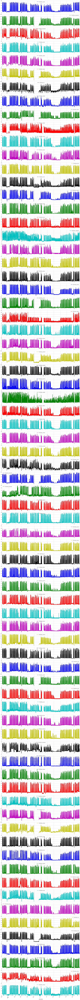

Plotting PrimClass with start time: 2012-02-02 00:00:00
This includes the following buildings: ['PrimClass_Ulysses', 'PrimClass_Una', 'PrimClass_Uriah', 'PrimClass_Uriel']


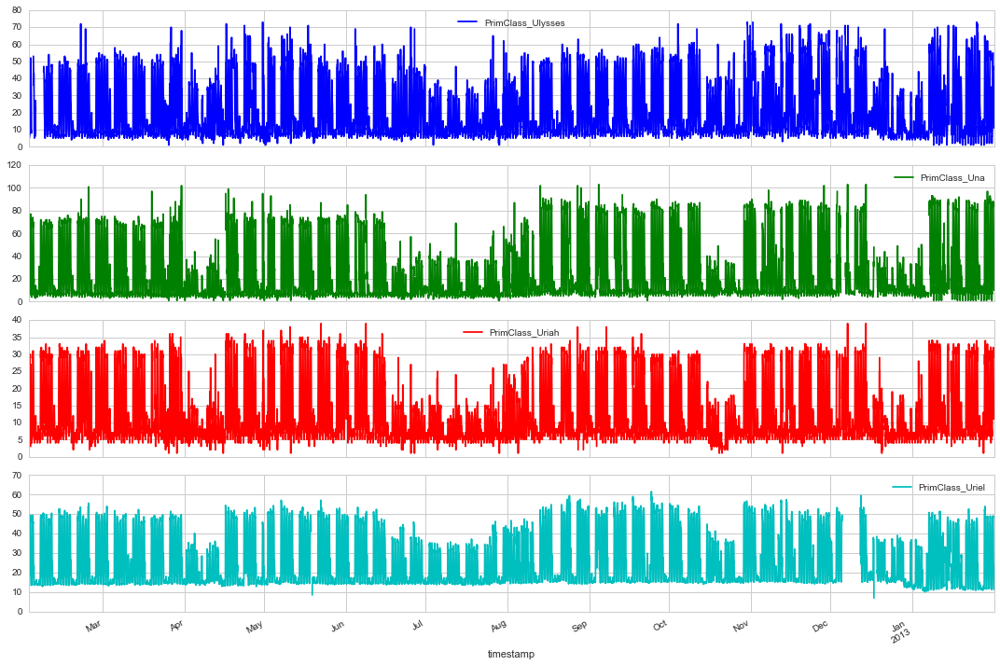

Plotting PrimClass with start time: 2013-01-01 00:00:00
This includes the following buildings: []
Plotting PrimClass with start time: 2014-05-01 00:00:00
This includes the following buildings: []
Plotting PrimClass with start time: 2014-11-01 00:00:00
This includes the following buildings: []
Plotting PrimClass with start time: 2010-01-01 00:00:00
This includes the following buildings: []


In [23]:
plot_buildingtype(meta, temp, "PrimClass")

# University Classrooms

Plotting UnivClass with start time: 2012-01-01 00:00:00
This includes the following buildings: ['UnivClass_Bernard', 'UnivClass_Britney', 'UnivClass_Brooke', 'UnivClass_Bryon']


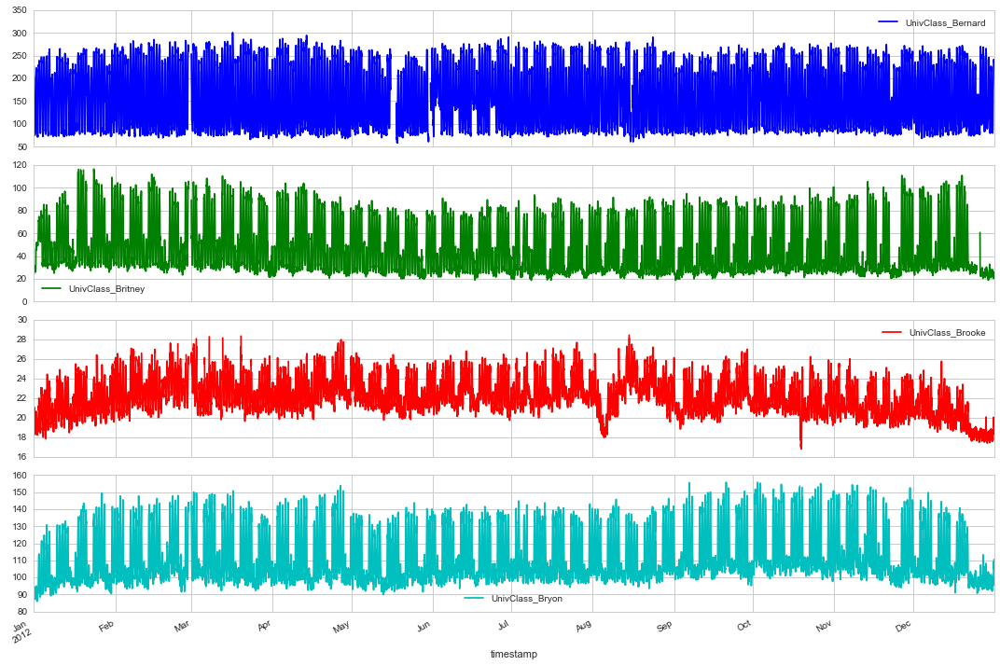

Plotting UnivClass with start time: 2015-01-01 00:00:00
This includes the following buildings: ['UnivClass_Abby', 'UnivClass_Adan', 'UnivClass_Adrienne', 'UnivClass_Agnes', 'UnivClass_Aidan', 'UnivClass_Aisling', 'UnivClass_Alaina', 'UnivClass_Alan', 'UnivClass_Alina', 'UnivClass_Allison', 'UnivClass_Alondra', 'UnivClass_Alphonso', 'UnivClass_Alyshialynn', 'UnivClass_Amber', 'UnivClass_Amy', 'UnivClass_Anahi', 'UnivClass_Andre', 'UnivClass_Andrew', 'UnivClass_Andy', 'UnivClass_Angel', 'UnivClass_Angus', 'UnivClass_Aniyah', 'UnivClass_Annabella', 'UnivClass_Antoinette', 'UnivClass_Anuja', 'UnivClass_Arnold', 'UnivClass_Arturo', 'UnivClass_Ashlyn', 'UnivClass_Ashlynn', 'UnivClass_Ava', 'UnivClass_Cadence', 'UnivClass_Callum', 'UnivClass_Camille', 'UnivClass_Carey', 'UnivClass_Carolina', 'UnivClass_Carter', 'UnivClass_Casey', 'UnivClass_Cathalina', 'UnivClass_Cathleen', 'UnivClass_Cecelia', 'UnivClass_Cesar', 'UnivClass_Chuck', 'UnivClass_Cillian', 'UnivClass_Cole', 'UnivClass_Connie', 'U

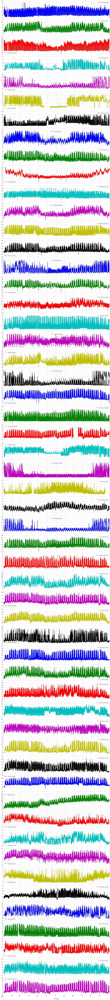

Plotting UnivClass with start time: 2014-12-01 00:00:00
This includes the following buildings: ['UnivClass_Jensen', 'UnivClass_Sandra', 'UnivClass_Sapphire', 'UnivClass_Savanna', 'UnivClass_Sheldon', 'UnivClass_Sinead', 'UnivClass_Skye', 'UnivClass_Stella', 'UnivClass_Stuart', 'UnivClass_Summer']


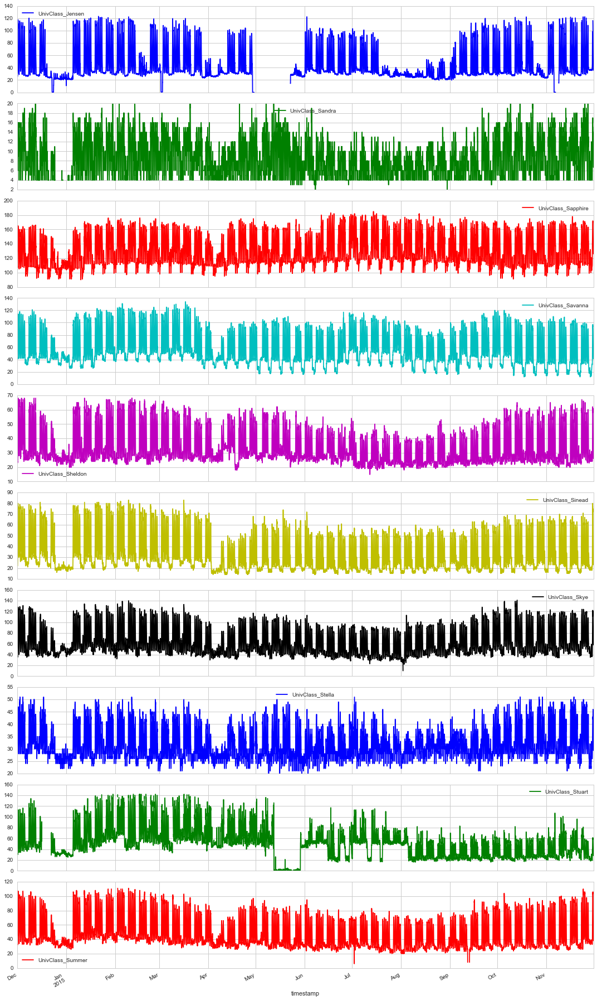

Plotting UnivClass with start time: 2012-02-02 00:00:00
This includes the following buildings: []
Plotting UnivClass with start time: 2013-01-01 00:00:00
This includes the following buildings: ['UnivClass_Teddy', 'UnivClass_Teri', 'UnivClass_Terry', 'UnivClass_Tom']


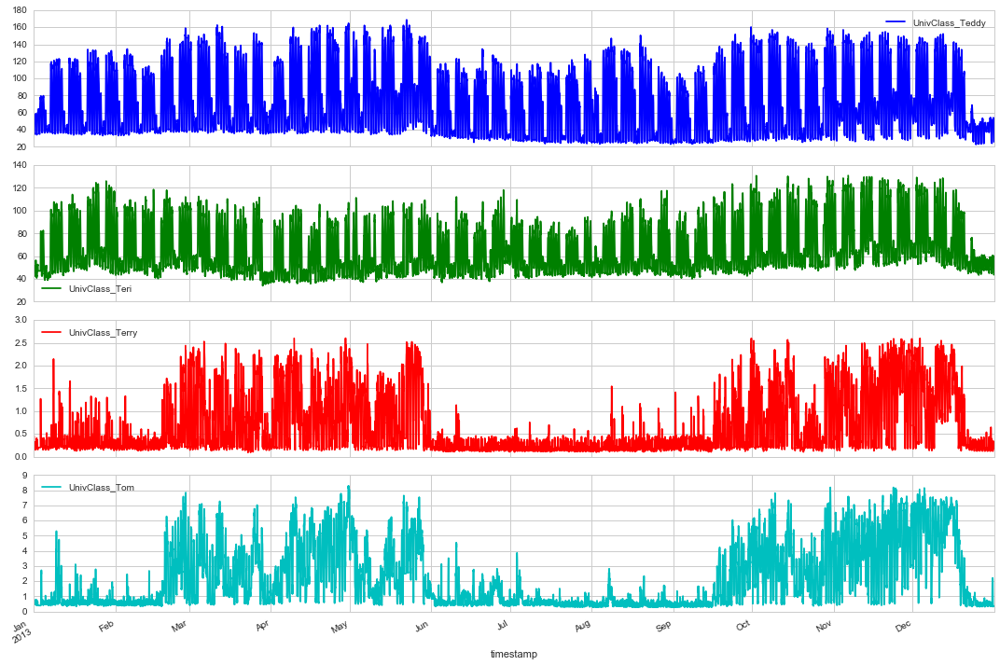

Plotting UnivClass with start time: 2014-05-01 00:00:00
This includes the following buildings: ['UnivClass_Marcia']


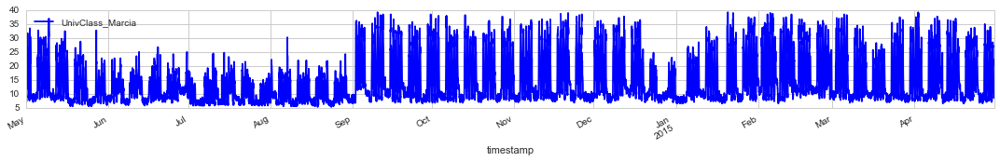

Plotting UnivClass with start time: 2014-11-01 00:00:00
This includes the following buildings: ['UnivClass_Nathanael', 'UnivClass_Nayeli', 'UnivClass_Neal', 'UnivClass_Nicole', 'UnivClass_Nishka', 'UnivClass_Noah', 'UnivClass_Noelle', 'UnivClass_Noreen']


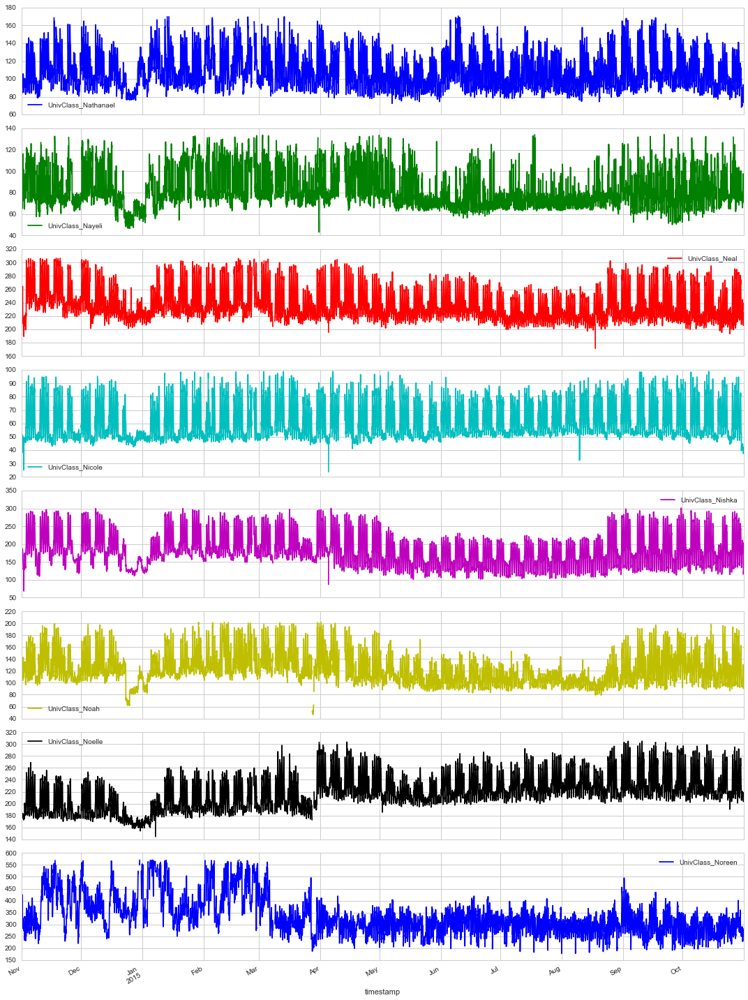

Plotting UnivClass with start time: 2010-01-01 00:00:00
This includes the following buildings: []


In [24]:
plot_buildingtype(meta, temp, "UnivClass")

# University Labs

Plotting UnivLab with start time: 2012-01-01 00:00:00
This includes the following buildings: ['UnivLab_Belinda', 'UnivLab_Betty', 'UnivLab_Bonita', 'UnivLab_Brenda', 'UnivLab_Briana']


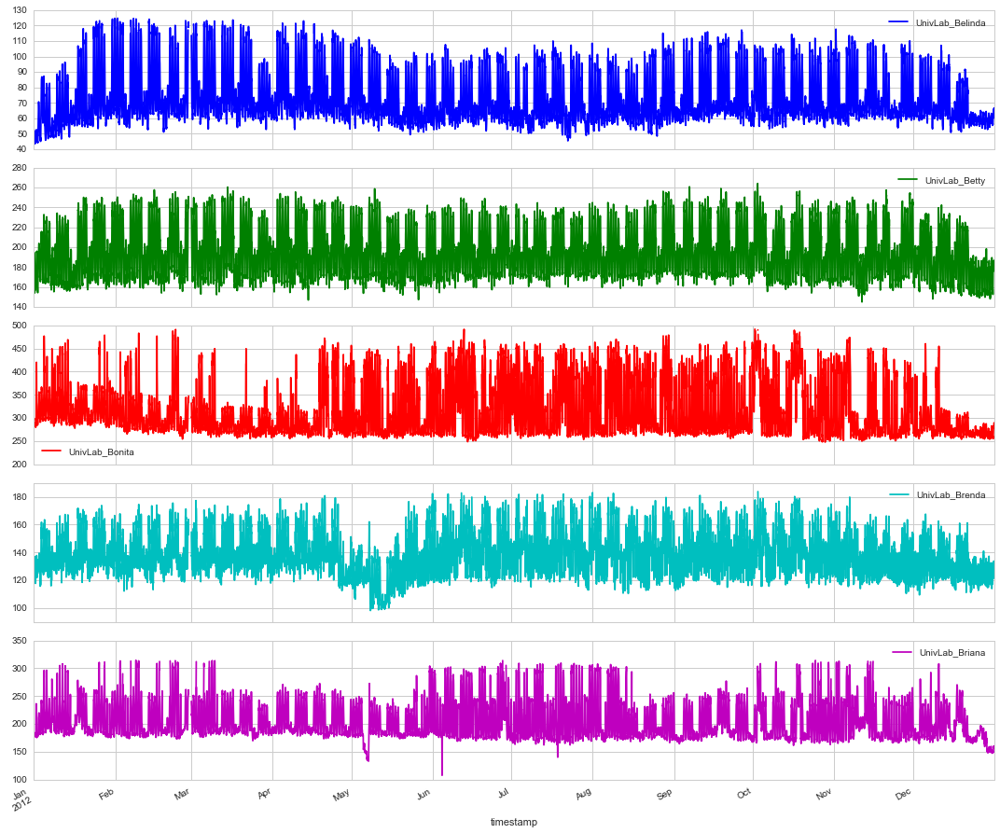

Plotting UnivLab with start time: 2015-01-01 00:00:00
This includes the following buildings: ['UnivLab_Abel', 'UnivLab_Adrianna', 'UnivLab_Alanna', 'UnivLab_Albert', 'UnivLab_Alex', 'UnivLab_Alexander', 'UnivLab_Alexis', 'UnivLab_Alfonso', 'UnivLab_Alisha', 'UnivLab_Alison', 'UnivLab_Alissa', 'UnivLab_Alivia', 'UnivLab_Aliyah', 'UnivLab_Alka', 'UnivLab_Andrea', 'UnivLab_Angie', 'UnivLab_Aniya', 'UnivLab_Ann', 'UnivLab_Annabelle', 'UnivLab_Annika', 'UnivLab_Anthony', 'UnivLab_Anya', 'UnivLab_Aoibhe', 'UnivLab_Arlene', 'UnivLab_Ashlee', 'UnivLab_Ashlie', 'UnivLab_Asia', 'UnivLab_Aurora', 'UnivLab_Ayden', 'UnivLab_Caitlyn', 'UnivLab_Cam', 'UnivLab_Camron', 'UnivLab_Candace', 'UnivLab_Carol', 'UnivLab_Carolyn', 'UnivLab_Cary', 'UnivLab_Casper', 'UnivLab_Cassandra', 'UnivLab_Catherine', 'UnivLab_Cecil', 'UnivLab_Cedric', 'UnivLab_Celeste', 'UnivLab_Chad', 'UnivLab_Charlene', 'UnivLab_Cherie', 'UnivLab_Cheryl', 'UnivLab_Chester', 'UnivLab_Cindy', 'UnivLab_Claire', 'UnivLab_Clarence', 'UnivLa

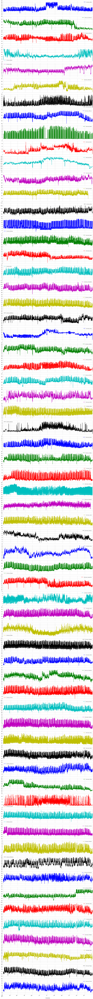

Plotting UnivLab with start time: 2014-12-01 00:00:00
This includes the following buildings: ['UnivLab_Ladonna', 'UnivLab_Laurie', 'UnivLab_Leopold', 'UnivLab_Lionel', 'UnivLab_Lizbeth', 'UnivLab_Lowell', 'UnivLab_Luann', 'UnivLab_Lynn', 'UnivLab_Samuel', 'UnivLab_Silas', 'UnivLab_Skylar']


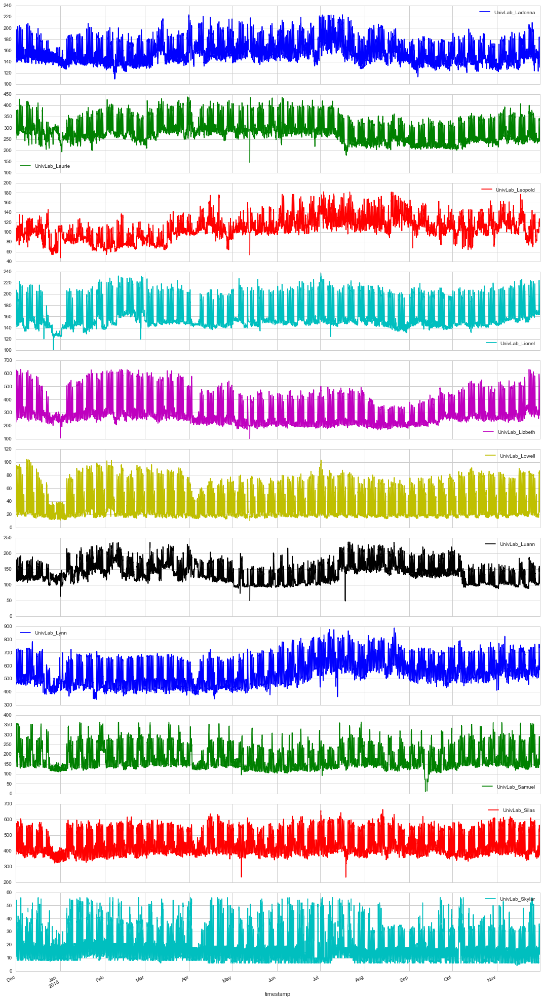

Plotting UnivLab with start time: 2012-02-02 00:00:00
This includes the following buildings: []
Plotting UnivLab with start time: 2013-01-01 00:00:00
This includes the following buildings: ['UnivLab_Tammy', 'UnivLab_Theresa', 'UnivLab_Tilly', 'UnivLab_Tonya', 'UnivLab_Trina']


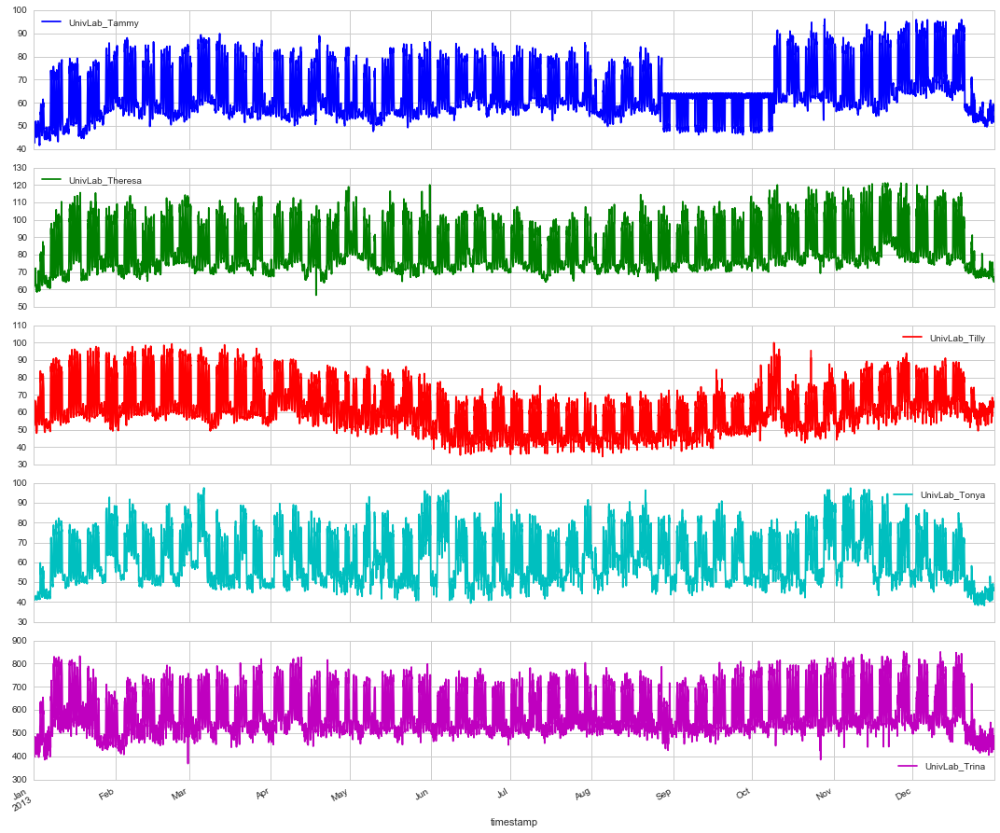

Plotting UnivLab with start time: 2014-05-01 00:00:00
This includes the following buildings: ['UnivLab_Mack', 'UnivLab_Maeve', 'UnivLab_Malachi', 'UnivLab_Marianne', 'UnivLab_Marina', 'UnivLab_Marjorie', 'UnivLab_Molly', 'UnivLab_Moses']


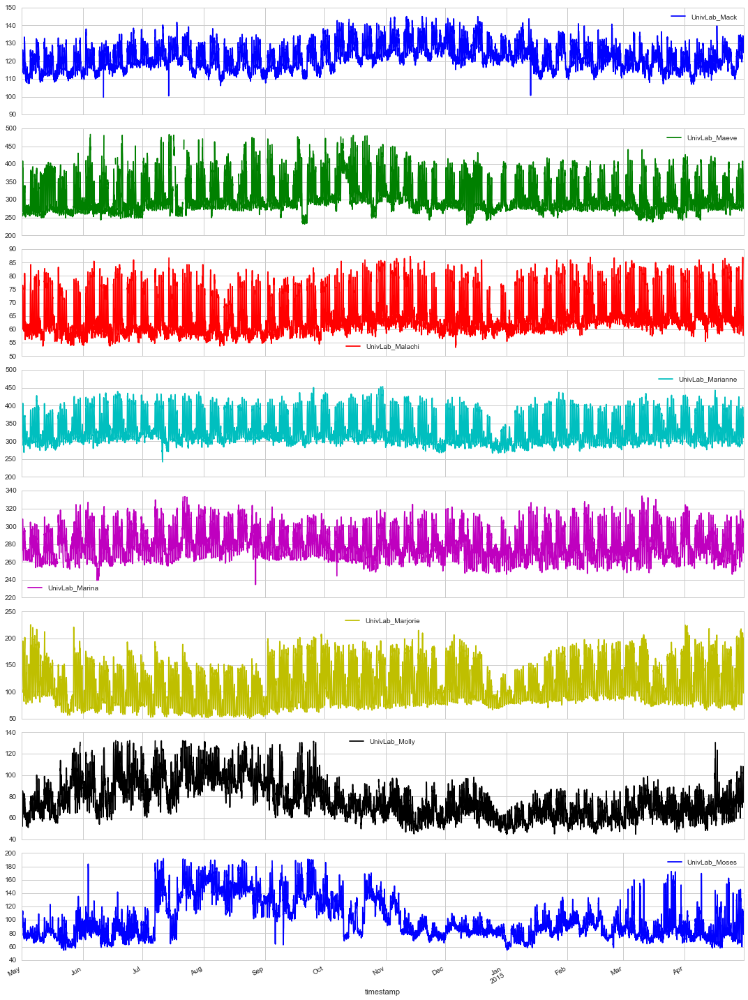

Plotting UnivLab with start time: 2014-11-01 00:00:00
This includes the following buildings: ['UnivLab_Nikolas']


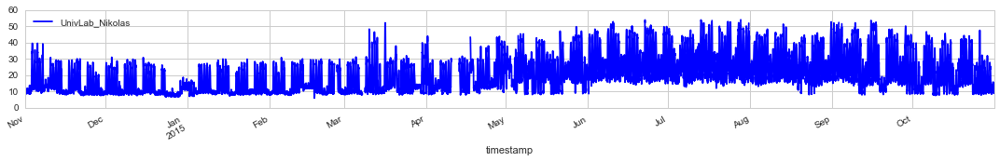

Plotting UnivLab with start time: 2010-01-01 00:00:00
This includes the following buildings: ['UnivLab_Barbara']


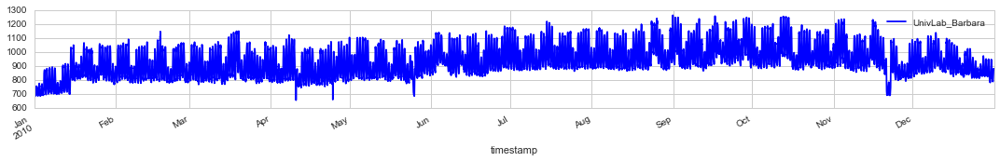

In [25]:
plot_buildingtype(meta, temp, "UnivLab")

# University Dorms

Plotting UnivDorm with start time: 2012-01-01 00:00:00
This includes the following buildings: []
Plotting UnivDorm with start time: 2015-01-01 00:00:00
This includes the following buildings: ['UnivDorm_Abbey', 'UnivDorm_Alberto', 'UnivDorm_Alexia', 'UnivDorm_Allan', 'UnivDorm_Alonzo', 'UnivDorm_America', 'UnivDorm_Amya', 'UnivDorm_Annette', 'UnivDorm_Annmarie', 'UnivDorm_Ashton', 'UnivDorm_Autumn', 'UnivDorm_Ayanna', 'UnivDorm_Ayesha', 'UnivDorm_Caitlin', 'UnivDorm_Camden', 'UnivDorm_Cameron', 'UnivDorm_Carissa', 'UnivDorm_Carla', 'UnivDorm_Carmen', 'UnivDorm_Carole', 'UnivDorm_Carrie', 'UnivDorm_Cassidy', 'UnivDorm_Cassie', 'UnivDorm_Celia', 'UnivDorm_Charlie', 'UnivDorm_Charlotte', 'UnivDorm_Chase', 'UnivDorm_Cheri', 'UnivDorm_Christian', 'UnivDorm_Christina', 'UnivDorm_Christine', 'UnivDorm_Cierra', 'UnivDorm_Clara', 'UnivDorm_Clay', 'UnivDorm_Clifford', 'UnivDorm_Clyde', 'UnivDorm_Colleen', 'UnivDorm_Colm', 'UnivDorm_Conner', 'UnivDorm_Cristian', 'UnivDorm_Paola', 'UnivDorm_Parker'

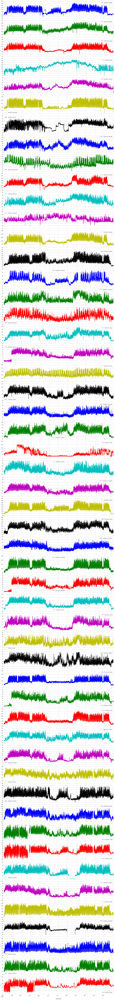

Plotting UnivDorm with start time: 2014-12-01 00:00:00
This includes the following buildings: ['UnivDorm_Jeanne', 'UnivDorm_Larry', 'UnivDorm_Lavana', 'UnivDorm_Leann', 'UnivDorm_Lewis', 'UnivDorm_Lexi', 'UnivDorm_Lori', 'UnivDorm_Luigi', 'UnivDorm_Lukas']


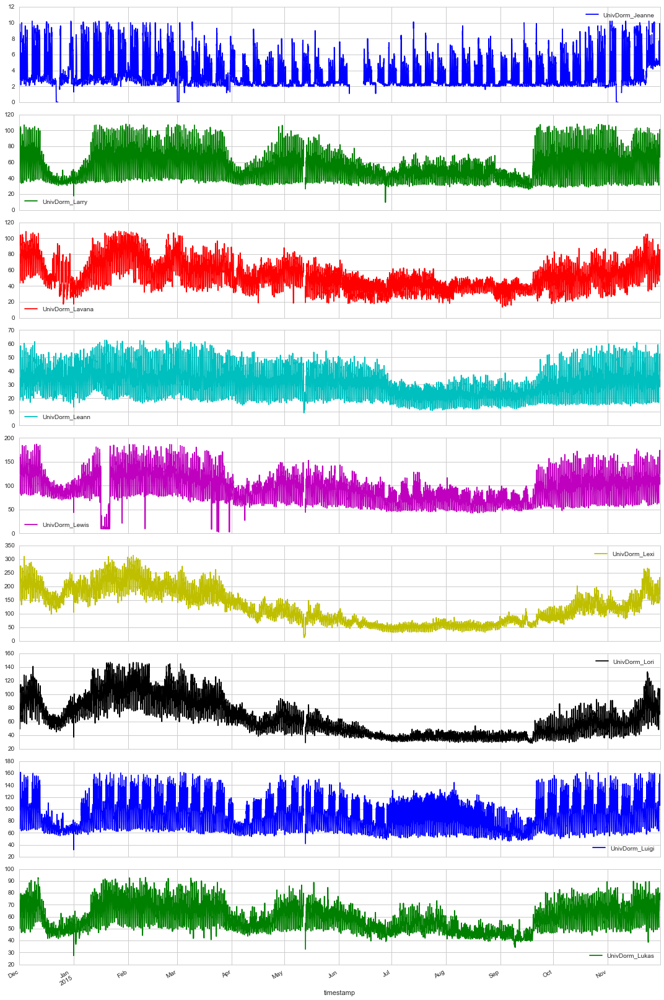

Plotting UnivDorm with start time: 2012-02-02 00:00:00
This includes the following buildings: ['UnivDorm_Ursula']


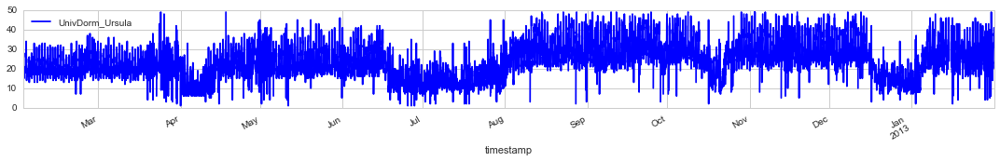

Plotting UnivDorm with start time: 2013-01-01 00:00:00
This includes the following buildings: []
Plotting UnivDorm with start time: 2014-05-01 00:00:00
This includes the following buildings: ['UnivDorm_Macy', 'UnivDorm_Makayla', 'UnivDorm_Mariana', 'UnivDorm_Marion', 'UnivDorm_Martin', 'UnivDorm_Maxine', 'UnivDorm_Meagan', 'UnivDorm_Monte']


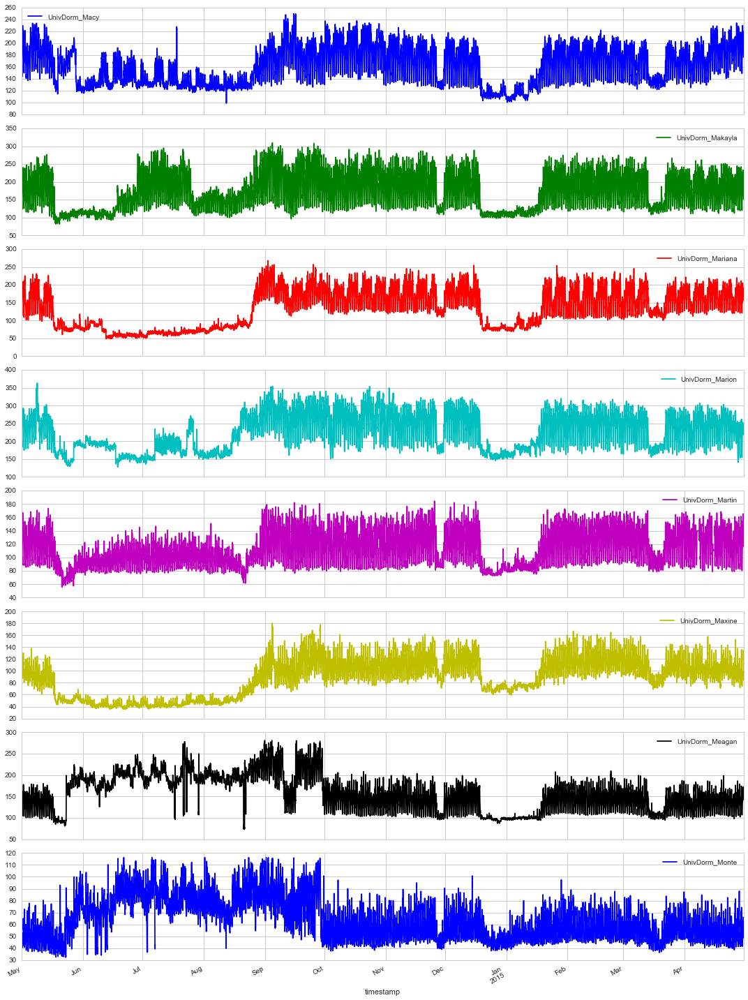

Plotting UnivDorm with start time: 2014-11-01 00:00:00
This includes the following buildings: []
Plotting UnivDorm with start time: 2010-01-01 00:00:00
This includes the following buildings: []


In [26]:
plot_buildingtype(meta, temp, "UnivDorm")

# Offices

Plotting Office with start time: 2012-01-01 00:00:00
This includes the following buildings: ['Office_Bernadette', 'Office_Betsy', 'Office_Billy', 'Office_Blaine', 'Office_Brandon', 'Office_Brenna', 'Office_Earl', 'Office_Earnest', 'Office_Edith', 'Office_Edmund', 'Office_Elijah', 'Office_Ellis', 'Office_Elyza', 'Office_Emmanuel', 'Office_Ernesto', 'Office_Esteban', 'Office_Eve']


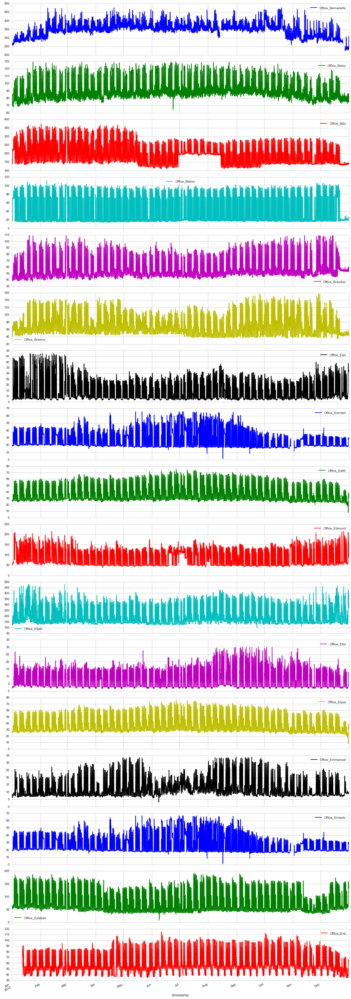

Plotting Office with start time: 2015-01-01 00:00:00
This includes the following buildings: ['Office_Adam', 'Office_Addison', 'Office_Ahmad', 'Office_Aine', 'Office_Al', 'Office_Alayna', 'Office_Alec', 'Office_Alfred', 'Office_Alfredo', 'Office_Allyson', 'Office_Alvin', 'Office_Amari', 'Office_Angelica', 'Office_Angelina', 'Office_Angelo', 'Office_Annabel', 'Office_Anne', 'Office_Annie', 'Office_Aoife', 'Office_Archie', 'Office_Asher', 'Office_Avery', 'Office_Cara', 'Office_Carly', 'Office_Caroline', 'Office_Cayden', 'Office_Chance', 'Office_Cheyanne', 'Office_Chris', 'Office_Christopher', 'Office_Christy', 'Office_Cian', 'Office_Cody', 'Office_Collin', 'Office_Cora', 'Office_Cornelius', 'Office_Cory', 'Office_Courtney', 'Office_Curt', 'Office_Pam', 'Office_Pamela', 'Office_Patricia', 'Office_Paula', 'Office_Paulette', 'Office_Payton', 'Office_Pedro', 'Office_Penny', 'Office_Perry', 'Office_Peyton', 'Office_Phil', 'Office_Phillip', 'Office_Preston', 'Office_Priscilla']


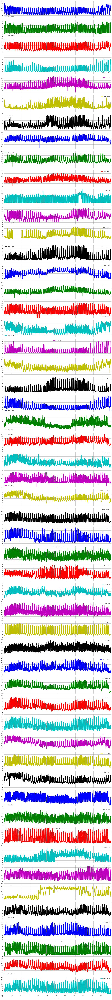

Plotting Office with start time: 2014-12-01 00:00:00
This includes the following buildings: ['Office_Gabriela', 'Office_Gail', 'Office_Gemma', 'Office_Gerard', 'Office_Gerardo', 'Office_Gianna', 'Office_Gilberto', 'Office_Grant', 'Office_Grayson', 'Office_Griffin', 'Office_Guy', 'Office_Gwen', 'Office_Jackson', 'Office_Janette', 'Office_Janine', 'Office_Jaxson', 'Office_Jayda', 'Office_Jayla', 'Office_Jeannette', 'Office_Jeff', 'Office_Jerri', 'Office_Josephine', 'Office_Josiah', 'Office_Juanita', 'Office_Julio', 'Office_Lana', 'Office_Lance', 'Office_Landon', 'Office_Lane', 'Office_Lee', 'Office_Leon', 'Office_Louis', 'Office_Santiago', 'Office_Sarah', 'Office_Saul', 'Office_Sidney', 'Office_Sophia', 'Office_Staci', 'Office_Stacie']


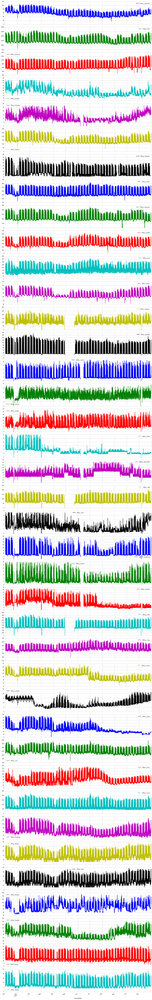

Plotting Office with start time: 2012-02-02 00:00:00
This includes the following buildings: []
Plotting Office with start time: 2013-01-01 00:00:00
This includes the following buildings: ['Office_Thomas', 'Office_Tracy', 'Office_Tyrese']


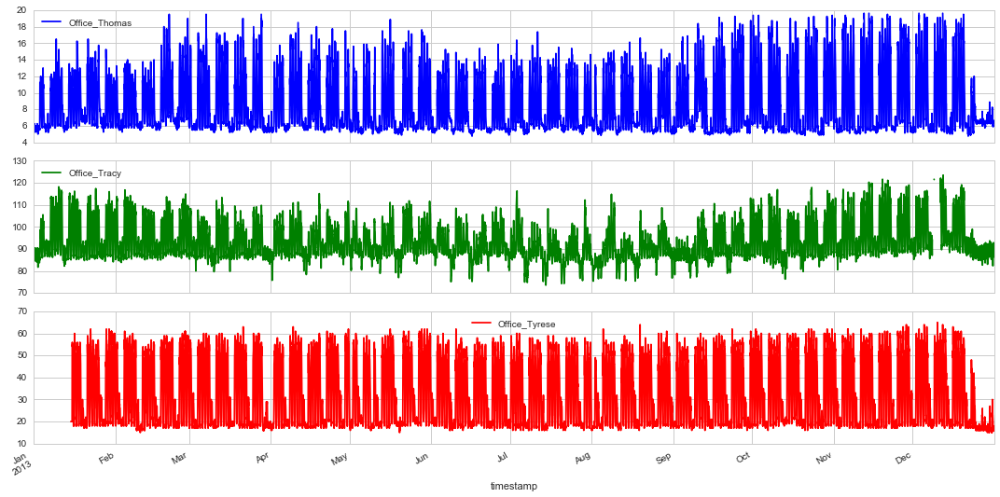

Plotting Office with start time: 2014-05-01 00:00:00
This includes the following buildings: ['Office_Madelyn', 'Office_Madison', 'Office_Madisyn', 'Office_Madyson', 'Office_Makenna', 'Office_Makenzie', 'Office_Malcolm', 'Office_Manuel', 'Office_Marci', 'Office_Marco', 'Office_Marcus', 'Office_Marcy', 'Office_Mario', 'Office_Marisa', 'Office_Mark', 'Office_Marsha', 'Office_Marty', 'Office_Mary', 'Office_Mason', 'Office_Mat', 'Office_Maurice', 'Office_Max', 'Office_Maximilian', 'Office_Maximus', 'Office_Melanie', 'Office_Michael', 'Office_Mick', 'Office_Mickey', 'Office_Miguel', 'Office_Miles', 'Office_Millie', 'Office_Milton', 'Office_Miriam', 'Office_Misty', 'Office_Mitchell', 'Office_Mohamed', 'Office_Mohammed', 'Office_Mona', 'Office_Monica']


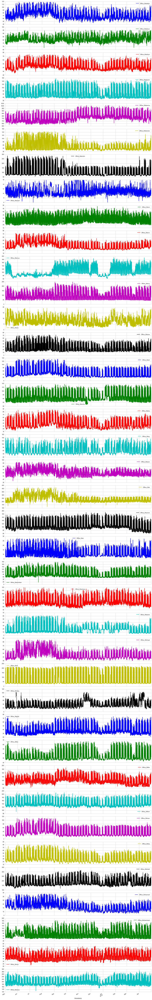

Plotting Office with start time: 2014-11-01 00:00:00
This includes the following buildings: ['Office_Nesbit', 'Office_Niall', 'Office_Nicholas']


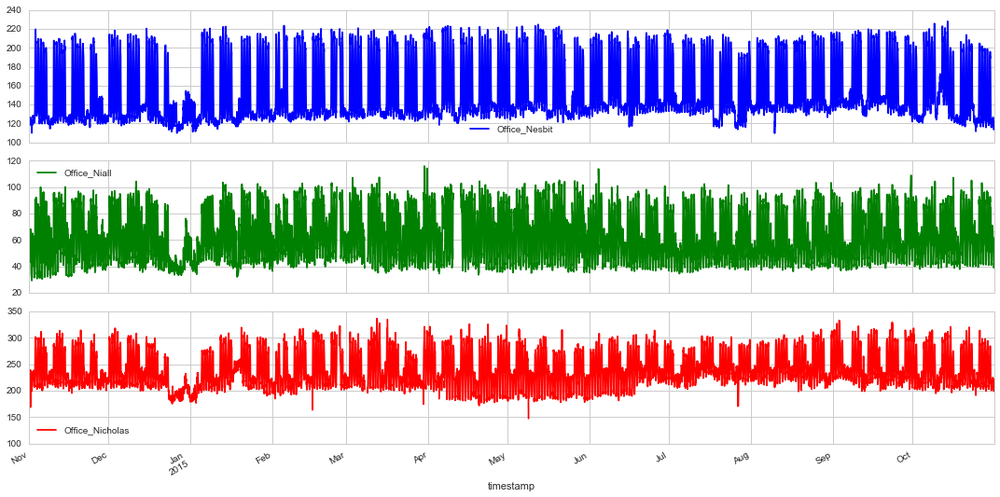

Plotting Office with start time: 2010-01-01 00:00:00
This includes the following buildings: ['Office_Brennan', 'Office_Brock']


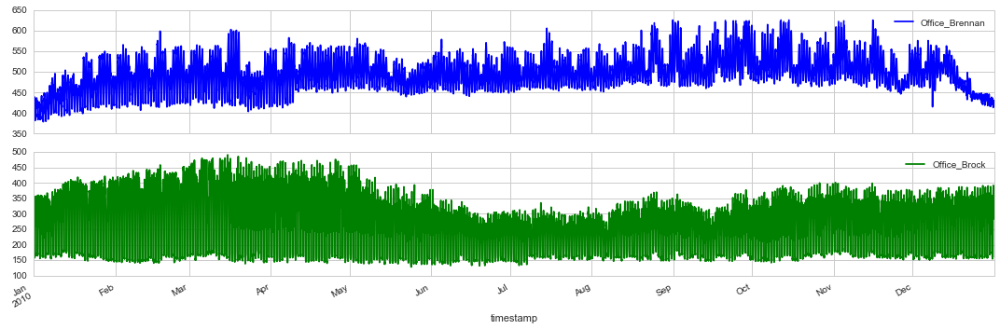

In [27]:
plot_buildingtype(meta, temp, "Office")